In [2]:
import numpy as np
import pandas as pd

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

import matplotlib.pyplot as plt

import seaborn as sns

In [11]:
def create_tsne_plots(dataset_name, dataset_target_version, dataset_title_name, labels, font_size=14):
    
    approaches = ["Adversarial Debiasing", "Adversarial Shared Encoder", "BASE Loss", "Baseline", "Contrastive Training", "Domain Independent", "Entangling Disentangling", "Feature Distillation", "Image Sketching"]
    for a in approaches:   
        file_path = f"../../latent_embeddings/{dataset_name}/{dataset_target_version}/{a} Embedding.npy"
        data = np.load(file_path)
        df = pd.DataFrame(data)
        if data.shape[1] != 514:
            raise ValueError("Embedding dimension mismatch")
        
        tsne = TSNE(n_components=2, verbose=1, perplexity=30, n_iter=300)
        tsne_results = tsne.fit_transform(data)
        df['tsne-2d-one'] = tsne_results[:,0]
        df['tsne-2d-two'] = tsne_results[:,1]
        
        plt.figure(figsize=(16,10))
        scatter = sns.scatterplot(
            x="tsne-2d-one", y="tsne-2d-two",
            hue=512,
            palette=sns.color_palette("tab10"),
            style=513,
            data=df,
            legend="full",
            alpha=0.9
        )
        
        # new_labels = ['Target', 'Not Smiling', "Smiling", "Gender", "Female", "Male"] 
        new_labels = labels
        handles, _ = scatter.get_legend_handles_labels()
        print(labels)
        scatter.legend(handles=handles[:len(new_labels)], labels=new_labels)
        plt.title(f"TSNE Visualization for {a} ({dataset_title_name})")
        plt.xlabel("")
        plt.ylabel("")
        
        # legend = plt.gca().get_legend()
        # Increase legend fontsize
        #for text in legend.get_texts():
        #    if text.get_text() in ['Target', 'Gender']:
        #        text.set_fontsize(14)
        plt.tight_layout()
        plt.savefig(f"../dataset_plots/tsne/{dataset_name}_{dataset_target_version} {a}.png", dpi=200)
        plt.show()

In [17]:
def create_tsne_plots_split(dataset_name, dataset_target_version, dataset_title_name, label_target, label_sensitive, font_size=18):
    
    approaches = ["Adversarial Debiasing", "Adversarial Shared Encoder", "BASE Loss", "Baseline", "Contrastive Training", "Domain Independent", "Entangling Disentangling", "Feature Distillation", "Image Sketching"]
    for a in approaches:   
        file_path = f"../../latent_embeddings/{dataset_name}/{dataset_target_version}/{a} Embedding.npy"
        data = np.load(file_path)
        df = pd.DataFrame(data)
        if data.shape[1] != 514:
            raise ValueError("Embedding dimension mismatch")
        
        tsne = TSNE(n_components=2, verbose=1, perplexity=30, n_iter=300)
        tsne_results = tsne.fit_transform(data)
        df['tsne-2d-one'] = tsne_results[:,0]
        df['tsne-2d-two'] = tsne_results[:,1]
        
        fig, axes = plt.subplots(1, 2, figsize=(32, 10))
    
        scatter_512 = sns.scatterplot(
            x="tsne-2d-one", y="tsne-2d-two",
            hue=512,
            palette=sns.color_palette("tab10"),
            data=df,
            legend="full",
            alpha=0.9,
            ax=axes[0]
        )
        scatter_512.set_title(f"TSNE Visualization for {a} (Target Attribute) - {dataset_title_name}", fontsize=font_size)
        scatter_512.set_xlabel("")
        scatter_512.set_ylabel("")
    
        scatter_513 = sns.scatterplot(
            x="tsne-2d-one", y="tsne-2d-two",
            hue=513,
            palette=sns.color_palette("Set1"),
            data=df,
            legend="full",
            alpha=0.9,
            ax=axes[1]
        )
        scatter_513.set_title(f"TSNE Visualization for {a} (Sensitive Attribute) - {dataset_title_name}", fontsize=font_size)
        scatter_513.set_xlabel("")
        scatter_513.set_ylabel("")
    
        handles_512, old_labels = scatter_512.get_legend_handles_labels()
        print(old_labels)
        scatter_512.legend(handles=handles_512[:len(label_target)], labels=label_target, fontsize=font_size)
        
        handles_513, old_labels = scatter_513.get_legend_handles_labels()
        print(old_labels)
        scatter_513.legend(handles=handles_513[:len(label_sensitive)], labels=label_sensitive, fontsize=font_size)
        
        plt.tight_layout()
        plt.savefig(f"../dataset_plots/tsne/{dataset_name}_{dataset_target_version} {a}.png", dpi=200)
        plt.show()


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1160 samples in 0.000s...
[t-SNE] Computed neighbors for 1160 samples in 0.026s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1160
[t-SNE] Computed conditional probabilities for sample 1160 / 1160
[t-SNE] Mean sigma: 1.179963
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.459492
[t-SNE] KL divergence after 300 iterations: 0.716769
['0.0', '1.0']
['0.0', '1.0']


/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (2), which may not be intended.
  scatter_513 = sns.scatterplot(


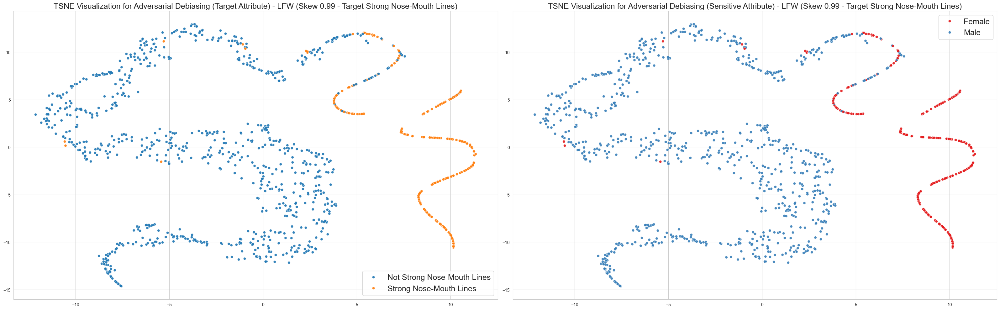

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1160 samples in 0.000s...
[t-SNE] Computed neighbors for 1160 samples in 0.018s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1160
[t-SNE] Computed conditional probabilities for sample 1160 / 1160
[t-SNE] Mean sigma: 0.608654
[t-SNE] KL divergence after 250 iterations with early exaggeration: 48.994846
[t-SNE] KL divergence after 300 iterations: 0.680187
['0.0', '1.0']
['0.0', '1.0']


/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (2), which may not be intended.
  scatter_513 = sns.scatterplot(


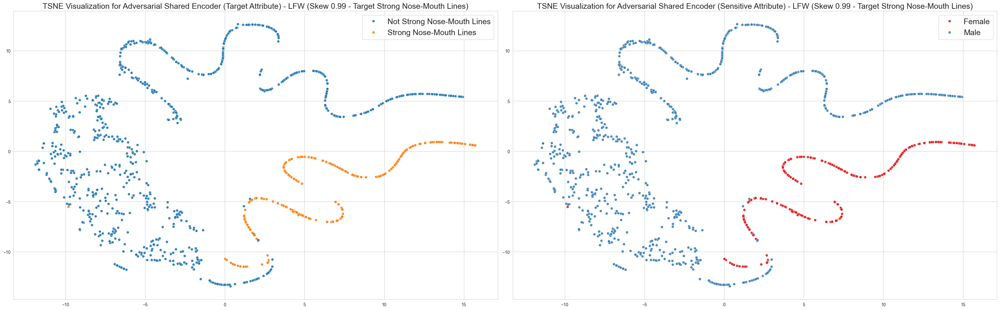

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1160 samples in 0.000s...
[t-SNE] Computed neighbors for 1160 samples in 0.019s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1160
[t-SNE] Computed conditional probabilities for sample 1160 / 1160
[t-SNE] Mean sigma: 1.069019
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.499882
[t-SNE] KL divergence after 300 iterations: 1.498570
['0.0', '1.0']
['0.0', '1.0']


/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (2), which may not be intended.
  scatter_513 = sns.scatterplot(


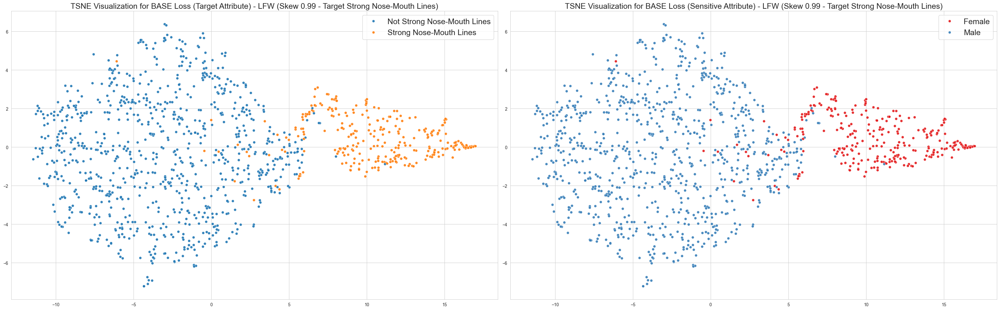

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1024 samples in 0.000s...
[t-SNE] Computed neighbors for 1024 samples in 0.017s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1024
[t-SNE] Computed conditional probabilities for sample 1024 / 1024
[t-SNE] Mean sigma: 1.046798
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.039242
[t-SNE] KL divergence after 300 iterations: 1.243507
['0.0', '1.0']
['0.0', '1.0']


/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (2), which may not be intended.
  scatter_513 = sns.scatterplot(


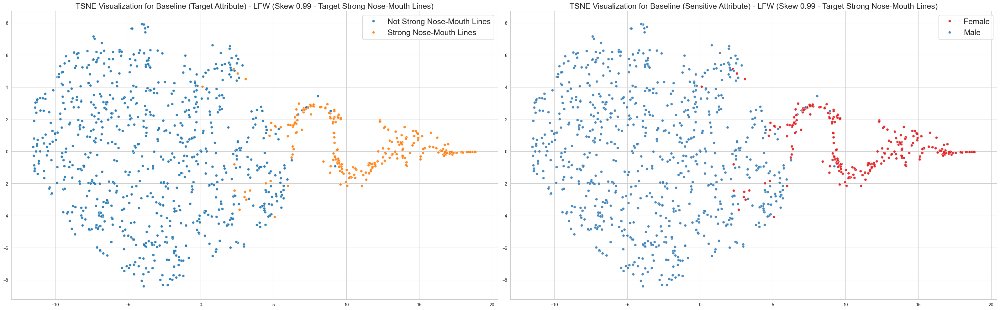

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1160 samples in 0.000s...
[t-SNE] Computed neighbors for 1160 samples in 0.020s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1160
[t-SNE] Computed conditional probabilities for sample 1160 / 1160
[t-SNE] Mean sigma: 6.641999
[t-SNE] KL divergence after 100 iterations with early exaggeration: 70.786278
[t-SNE] KL divergence after 300 iterations: 1.637453
['0.0', '1.0']
['0.0', '1.0']


/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (2), which may not be intended.
  scatter_513 = sns.scatterplot(


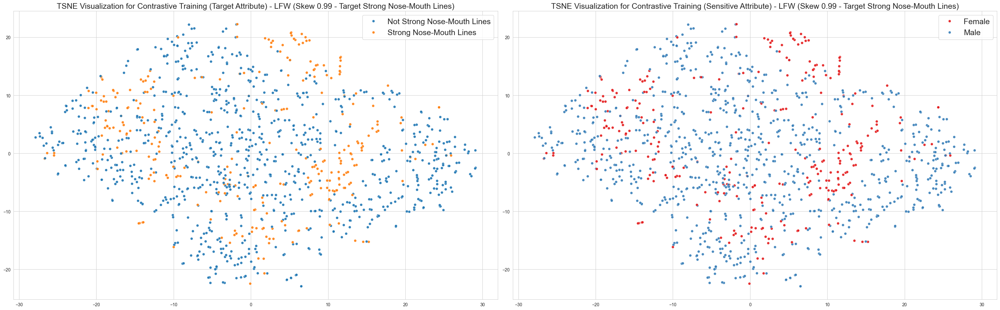

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1160 samples in 0.000s...
[t-SNE] Computed neighbors for 1160 samples in 0.020s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1160
[t-SNE] Computed conditional probabilities for sample 1160 / 1160
[t-SNE] Mean sigma: 0.812110
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.648979
[t-SNE] KL divergence after 300 iterations: 1.566614
['0.0', '1.0']
['0.0', '1.0']


/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (2), which may not be intended.
  scatter_513 = sns.scatterplot(


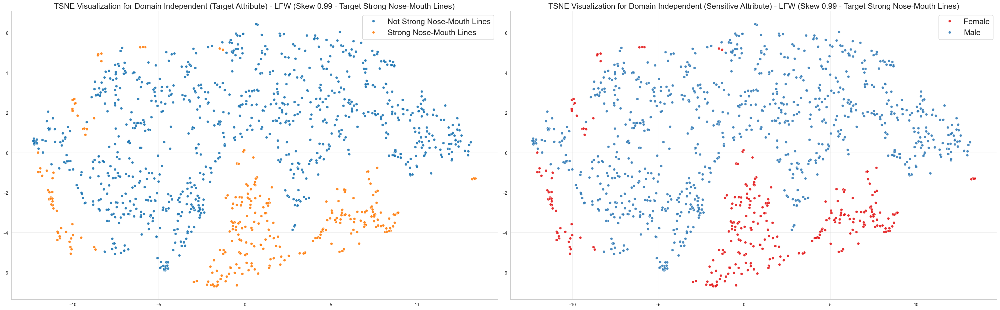

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1160 samples in 0.000s...
[t-SNE] Computed neighbors for 1160 samples in 0.019s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1160
[t-SNE] Computed conditional probabilities for sample 1160 / 1160
[t-SNE] Mean sigma: 0.028137
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.221466
[t-SNE] KL divergence after 300 iterations: 0.661373
['0.0', '1.0']
['0.0', '1.0']


/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (2), which may not be intended.
  scatter_513 = sns.scatterplot(


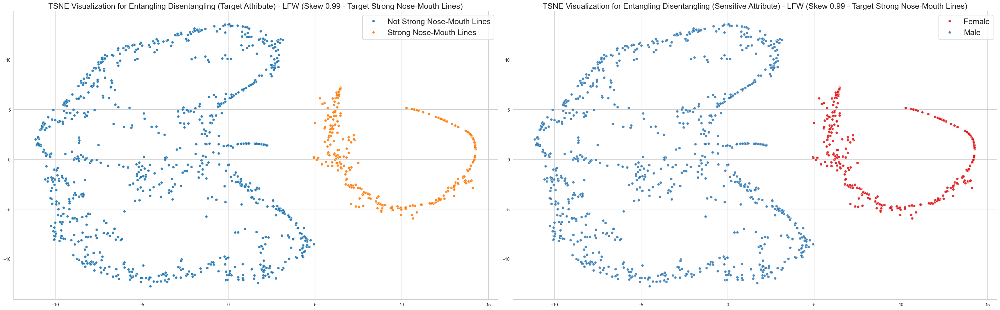

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1160 samples in 0.000s...
[t-SNE] Computed neighbors for 1160 samples in 0.022s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1160
[t-SNE] Computed conditional probabilities for sample 1160 / 1160
[t-SNE] Mean sigma: 1.173051
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.422119
[t-SNE] KL divergence after 300 iterations: 1.380009
['0.0', '1.0']
['0.0', '1.0']


/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (2), which may not be intended.
  scatter_513 = sns.scatterplot(


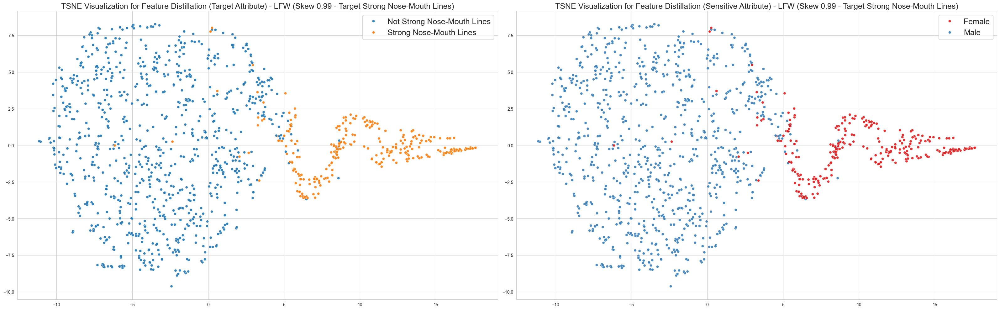

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1160 samples in 0.000s...
[t-SNE] Computed neighbors for 1160 samples in 0.021s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1160
[t-SNE] Computed conditional probabilities for sample 1160 / 1160
[t-SNE] Mean sigma: 1.042152
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.943527
[t-SNE] KL divergence after 300 iterations: 1.417466
['0.0', '1.0']
['0.0', '1.0']


/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (2), which may not be intended.
  scatter_513 = sns.scatterplot(


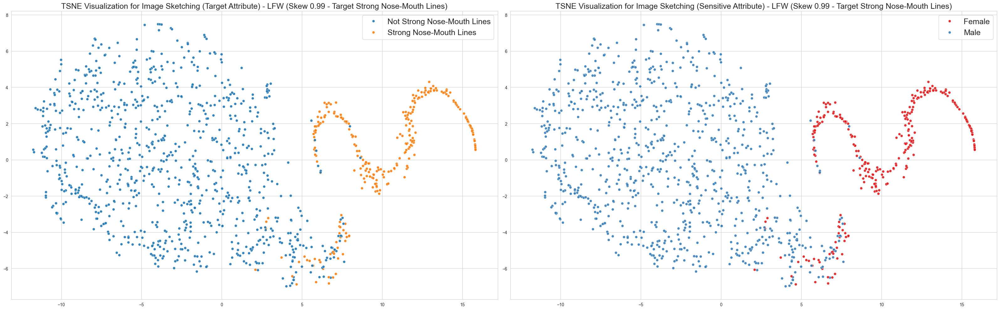

In [23]:
create_tsne_plots_split("lfw", "skew099_v1_strong_nose", "LFW (Skew 0.99 - Target Strong Nose-Mouth Lines)", label_target=["Not Strong Nose-Mouth Lines", "Strong Nose-Mouth Lines"], label_sensitive=["Female", "Male"] )

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10954 samples in 0.001s...
[t-SNE] Computed neighbors for 10954 samples in 0.559s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10954
[t-SNE] Computed conditional probabilities for sample 2000 / 10954
[t-SNE] Computed conditional probabilities for sample 3000 / 10954
[t-SNE] Computed conditional probabilities for sample 4000 / 10954
[t-SNE] Computed conditional probabilities for sample 5000 / 10954
[t-SNE] Computed conditional probabilities for sample 6000 / 10954
[t-SNE] Computed conditional probabilities for sample 7000 / 10954
[t-SNE] Computed conditional probabilities for sample 8000 / 10954
[t-SNE] Computed conditional probabilities for sample 9000 / 10954
[t-SNE] Computed conditional probabilities for sample 10000 / 10954
[t-SNE] Computed conditional probabilities for sample 10954 / 10954
[t-SNE] Mean sigma: 1.104067
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.814453
[t-SNE] KL 

/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (7), which may not be intended.
  scatter_513 = sns.scatterplot(


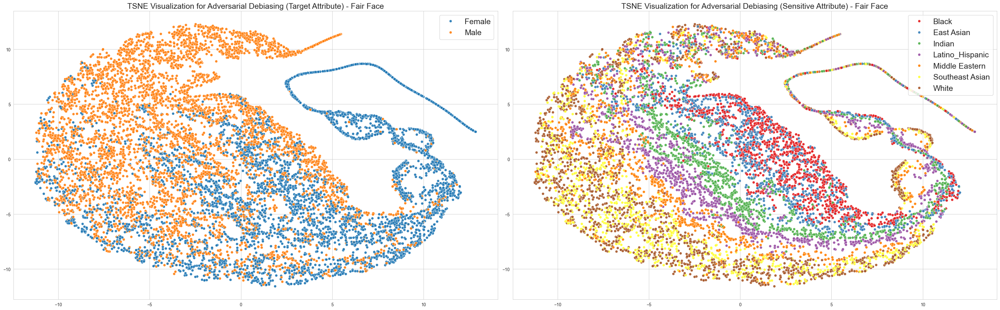

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10954 samples in 0.002s...
[t-SNE] Computed neighbors for 10954 samples in 0.642s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10954
[t-SNE] Computed conditional probabilities for sample 2000 / 10954
[t-SNE] Computed conditional probabilities for sample 3000 / 10954
[t-SNE] Computed conditional probabilities for sample 4000 / 10954
[t-SNE] Computed conditional probabilities for sample 5000 / 10954
[t-SNE] Computed conditional probabilities for sample 6000 / 10954
[t-SNE] Computed conditional probabilities for sample 7000 / 10954
[t-SNE] Computed conditional probabilities for sample 8000 / 10954
[t-SNE] Computed conditional probabilities for sample 9000 / 10954
[t-SNE] Computed conditional probabilities for sample 10000 / 10954
[t-SNE] Computed conditional probabilities for sample 10954 / 10954
[t-SNE] Mean sigma: 1.006531
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.036797
[t-SNE] KL 

/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (7), which may not be intended.
  scatter_513 = sns.scatterplot(


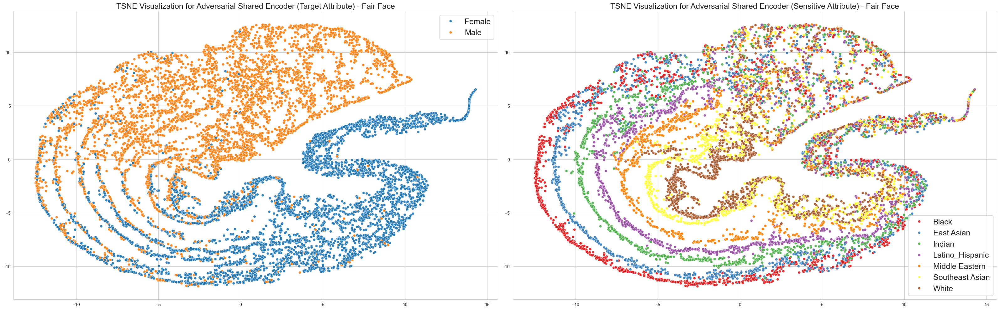

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10954 samples in 0.001s...
[t-SNE] Computed neighbors for 10954 samples in 0.590s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10954
[t-SNE] Computed conditional probabilities for sample 2000 / 10954
[t-SNE] Computed conditional probabilities for sample 3000 / 10954
[t-SNE] Computed conditional probabilities for sample 4000 / 10954
[t-SNE] Computed conditional probabilities for sample 5000 / 10954
[t-SNE] Computed conditional probabilities for sample 6000 / 10954
[t-SNE] Computed conditional probabilities for sample 7000 / 10954
[t-SNE] Computed conditional probabilities for sample 8000 / 10954
[t-SNE] Computed conditional probabilities for sample 9000 / 10954
[t-SNE] Computed conditional probabilities for sample 10000 / 10954
[t-SNE] Computed conditional probabilities for sample 10954 / 10954
[t-SNE] Mean sigma: 1.150437
[t-SNE] KL divergence after 250 iterations with early exaggeration: 81.375687
[t-SNE] KL 

/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (7), which may not be intended.
  scatter_513 = sns.scatterplot(


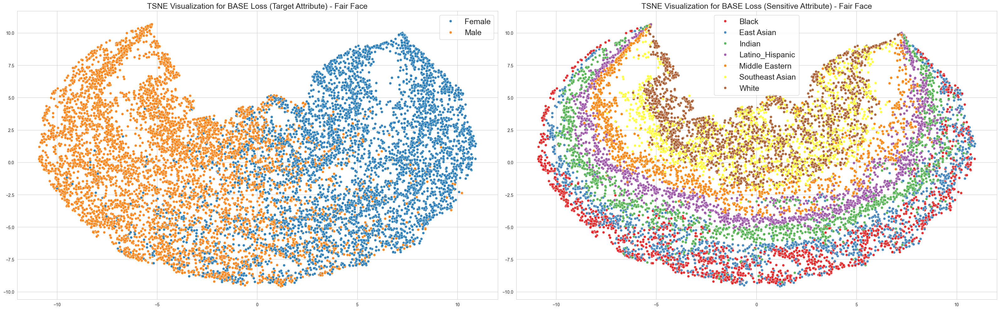

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10752 samples in 0.002s...
[t-SNE] Computed neighbors for 10752 samples in 0.472s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10752
[t-SNE] Computed conditional probabilities for sample 2000 / 10752
[t-SNE] Computed conditional probabilities for sample 3000 / 10752
[t-SNE] Computed conditional probabilities for sample 4000 / 10752
[t-SNE] Computed conditional probabilities for sample 5000 / 10752
[t-SNE] Computed conditional probabilities for sample 6000 / 10752
[t-SNE] Computed conditional probabilities for sample 7000 / 10752
[t-SNE] Computed conditional probabilities for sample 8000 / 10752
[t-SNE] Computed conditional probabilities for sample 9000 / 10752
[t-SNE] Computed conditional probabilities for sample 10000 / 10752
[t-SNE] Computed conditional probabilities for sample 10752 / 10752
[t-SNE] Mean sigma: 1.134090
[t-SNE] KL divergence after 250 iterations with early exaggeration: 78.442993
[t-SNE] KL 

/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (7), which may not be intended.
  scatter_513 = sns.scatterplot(


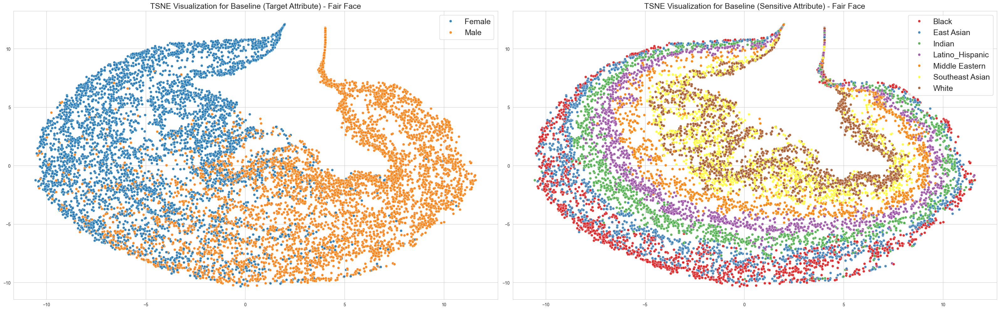

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10954 samples in 0.001s...
[t-SNE] Computed neighbors for 10954 samples in 0.482s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10954
[t-SNE] Computed conditional probabilities for sample 2000 / 10954
[t-SNE] Computed conditional probabilities for sample 3000 / 10954
[t-SNE] Computed conditional probabilities for sample 4000 / 10954
[t-SNE] Computed conditional probabilities for sample 5000 / 10954
[t-SNE] Computed conditional probabilities for sample 6000 / 10954
[t-SNE] Computed conditional probabilities for sample 7000 / 10954
[t-SNE] Computed conditional probabilities for sample 8000 / 10954
[t-SNE] Computed conditional probabilities for sample 9000 / 10954
[t-SNE] Computed conditional probabilities for sample 10000 / 10954
[t-SNE] Computed conditional probabilities for sample 10954 / 10954
[t-SNE] Mean sigma: 1.504959
[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.321671
[t-SNE] KL 

/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (7), which may not be intended.
  scatter_513 = sns.scatterplot(


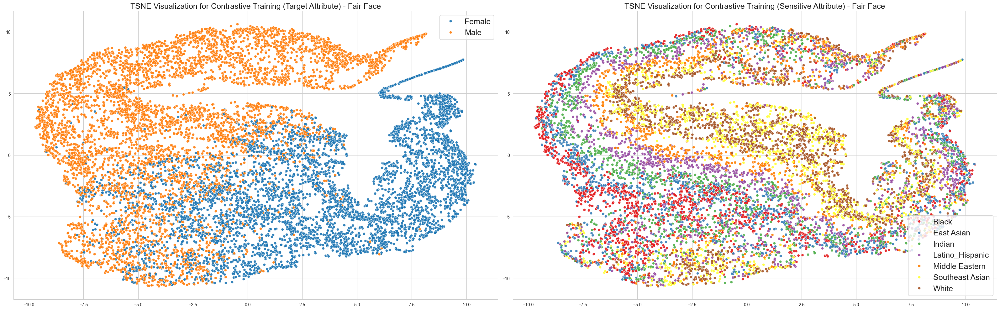

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10954 samples in 0.001s...
[t-SNE] Computed neighbors for 10954 samples in 0.478s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10954
[t-SNE] Computed conditional probabilities for sample 2000 / 10954
[t-SNE] Computed conditional probabilities for sample 3000 / 10954
[t-SNE] Computed conditional probabilities for sample 4000 / 10954
[t-SNE] Computed conditional probabilities for sample 5000 / 10954
[t-SNE] Computed conditional probabilities for sample 6000 / 10954
[t-SNE] Computed conditional probabilities for sample 7000 / 10954
[t-SNE] Computed conditional probabilities for sample 8000 / 10954
[t-SNE] Computed conditional probabilities for sample 9000 / 10954
[t-SNE] Computed conditional probabilities for sample 10000 / 10954
[t-SNE] Computed conditional probabilities for sample 10954 / 10954
[t-SNE] Mean sigma: 1.747039
[t-SNE] KL divergence after 250 iterations with early exaggeration: 83.953247
[t-SNE] KL 

/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (7), which may not be intended.
  scatter_513 = sns.scatterplot(


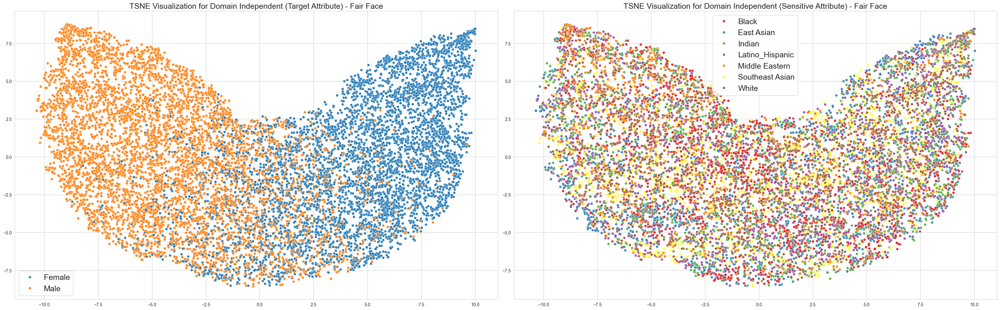

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10954 samples in 0.001s...
[t-SNE] Computed neighbors for 10954 samples in 0.705s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10954
[t-SNE] Computed conditional probabilities for sample 2000 / 10954
[t-SNE] Computed conditional probabilities for sample 3000 / 10954
[t-SNE] Computed conditional probabilities for sample 4000 / 10954
[t-SNE] Computed conditional probabilities for sample 5000 / 10954
[t-SNE] Computed conditional probabilities for sample 6000 / 10954
[t-SNE] Computed conditional probabilities for sample 7000 / 10954
[t-SNE] Computed conditional probabilities for sample 8000 / 10954
[t-SNE] Computed conditional probabilities for sample 9000 / 10954
[t-SNE] Computed conditional probabilities for sample 10000 / 10954
[t-SNE] Computed conditional probabilities for sample 10954 / 10954
[t-SNE] Mean sigma: 0.040188
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.304741
[t-SNE] KL 

/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (7), which may not be intended.
  scatter_513 = sns.scatterplot(


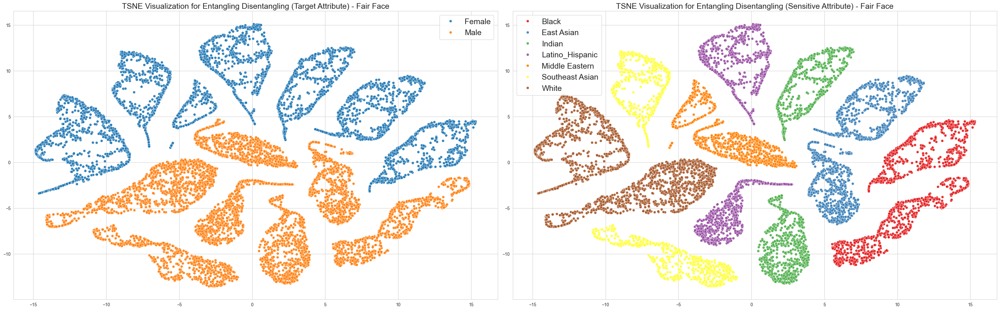

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10954 samples in 0.001s...
[t-SNE] Computed neighbors for 10954 samples in 0.469s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10954
[t-SNE] Computed conditional probabilities for sample 2000 / 10954
[t-SNE] Computed conditional probabilities for sample 3000 / 10954
[t-SNE] Computed conditional probabilities for sample 4000 / 10954
[t-SNE] Computed conditional probabilities for sample 5000 / 10954
[t-SNE] Computed conditional probabilities for sample 6000 / 10954
[t-SNE] Computed conditional probabilities for sample 7000 / 10954
[t-SNE] Computed conditional probabilities for sample 8000 / 10954
[t-SNE] Computed conditional probabilities for sample 9000 / 10954
[t-SNE] Computed conditional probabilities for sample 10000 / 10954
[t-SNE] Computed conditional probabilities for sample 10954 / 10954
[t-SNE] Mean sigma: 0.890148
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.547623
[t-SNE] KL 

/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (7), which may not be intended.
  scatter_513 = sns.scatterplot(


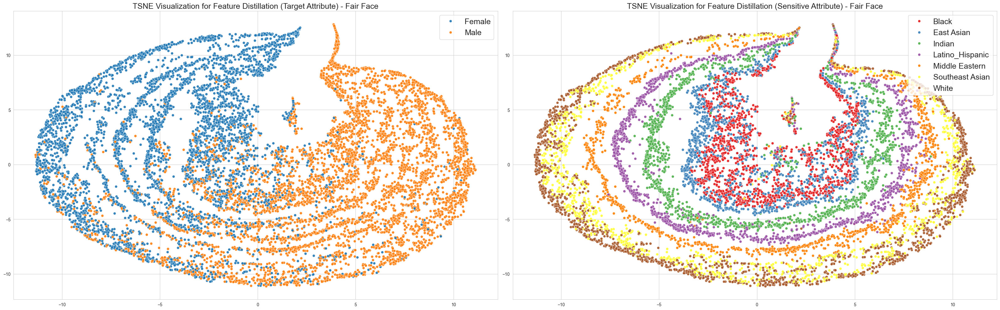

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 10954 samples in 0.001s...
[t-SNE] Computed neighbors for 10954 samples in 0.496s...
[t-SNE] Computed conditional probabilities for sample 1000 / 10954
[t-SNE] Computed conditional probabilities for sample 2000 / 10954
[t-SNE] Computed conditional probabilities for sample 3000 / 10954
[t-SNE] Computed conditional probabilities for sample 4000 / 10954
[t-SNE] Computed conditional probabilities for sample 5000 / 10954
[t-SNE] Computed conditional probabilities for sample 6000 / 10954
[t-SNE] Computed conditional probabilities for sample 7000 / 10954
[t-SNE] Computed conditional probabilities for sample 8000 / 10954
[t-SNE] Computed conditional probabilities for sample 9000 / 10954
[t-SNE] Computed conditional probabilities for sample 10000 / 10954
[t-SNE] Computed conditional probabilities for sample 10954 / 10954
[t-SNE] Mean sigma: 1.235752
[t-SNE] KL divergence after 250 iterations with early exaggeration: 78.764893
[t-SNE] KL 

/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:18: UserWarning: The palette list has more values (10) than needed (2), which may not be intended.
  scatter_512 = sns.scatterplot(
/var/folders/fv/hdmdsw6s3fv_72w1tfp22w9m0000gn/T/ipykernel_9851/3650906484.py:31: UserWarning: The palette list has more values (9) than needed (7), which may not be intended.
  scatter_513 = sns.scatterplot(


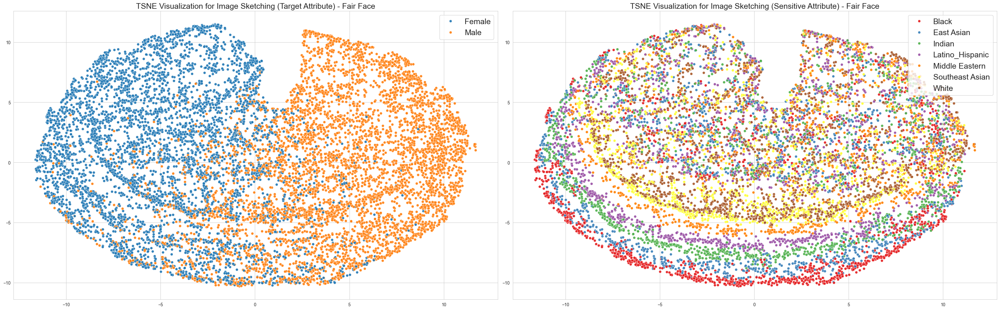

In [11]:
create_tsne_plots_split("fair_face", "v2_target_gender", "Fair Face", label_target=["Female", "Male"], label_sensitive=['Black', 'East Asian', 'Indian', 'Latino_Hispanic', 'Middle Eastern',
 'Southeast Asian', 'White'] )

['512', '0.0', '1.0', 'shape_label', 'square', 'circle']


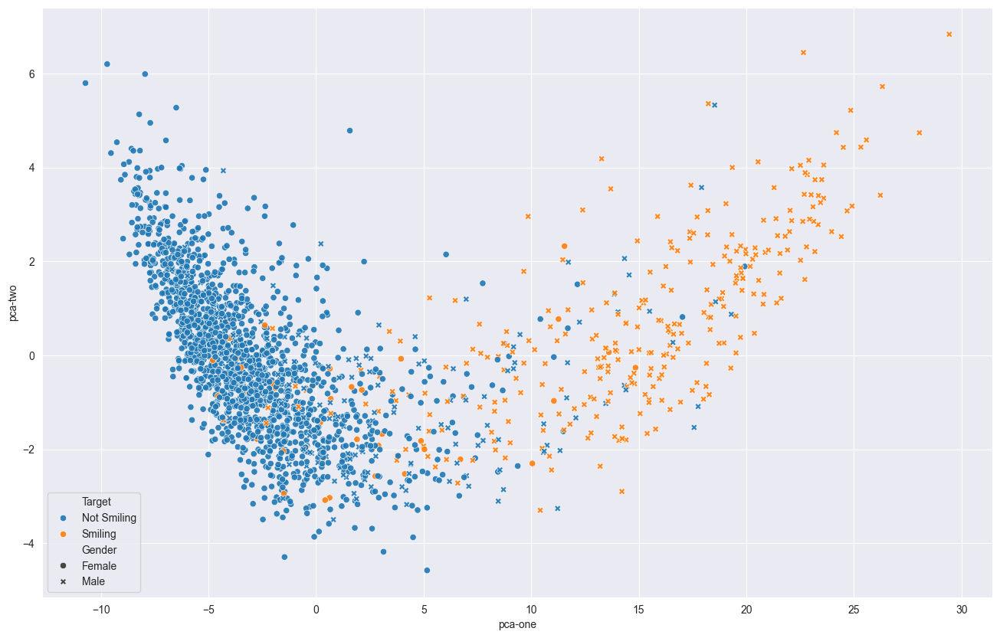

In [33]:
plt.figure(figsize=(16,10))
scatter = sns.scatterplot(
    x="pca-one", y="pca-two",
    hue=512,
    palette=sns.color_palette("tab10", 2),
    style="shape_label",
    data=df,
    legend="full",
    alpha=0.9
)

new_labels = ['Target', 'Not Smiling', "Smiling", "Gender", "Male", "Female"] 
handles, labels = scatter.get_legend_handles_labels()
print(labels)
scatter.legend(handles=handles[:len(new_labels)], labels=new_labels)

legend = plt.gca().get_legend()

plt.show()